## Practical Bioinformatics. Homework 2

### UCSC

The UCSC Genome Browser is developed by the UCSC (University of California Santa Cruz) Genomics Institute. 

The UCSC Genomes Database is a great resource for annotations, regulation and variation and all kinds of data for a growing number of taxa.

Let's choose any human protein and find any info about this protein gene in the UCSC Genome Browser:

I have chosen _Hemoglobin subunit alpha (HBA1)_ https://en.wikipedia.org/wiki/Hemoglobin_subunit_alpha.

At first, let's choose a reference genome.

Some reference genome assemblies are available (at the UCSC website we may find - Human GRCh38/hg38, Human GRCh37/hg19). GRCh37 and hg19 are the same but named differently based on the institution, Genome Reference Consortium (GRC) and the University of California at Santa Cruz (UCSC), respectively.

The same is true of GRCh38 and hg38. 

Both, GRCh37 and GRCh38 are human genome assemblies by the Genome Reference Consortium (GRC). GRCh38 (also called “build 38”) was released four years after the GRCh37 release in 2009, so it can be viewed as a version with updated annotations to the earlier assembly.

Let's select _hg38_.

Then we should see a view of the browser similar to the image below, opening at a position on the 16th chromosome of Human genome version GRCh38/hg38 showing the gene model for the HBA1 gene:

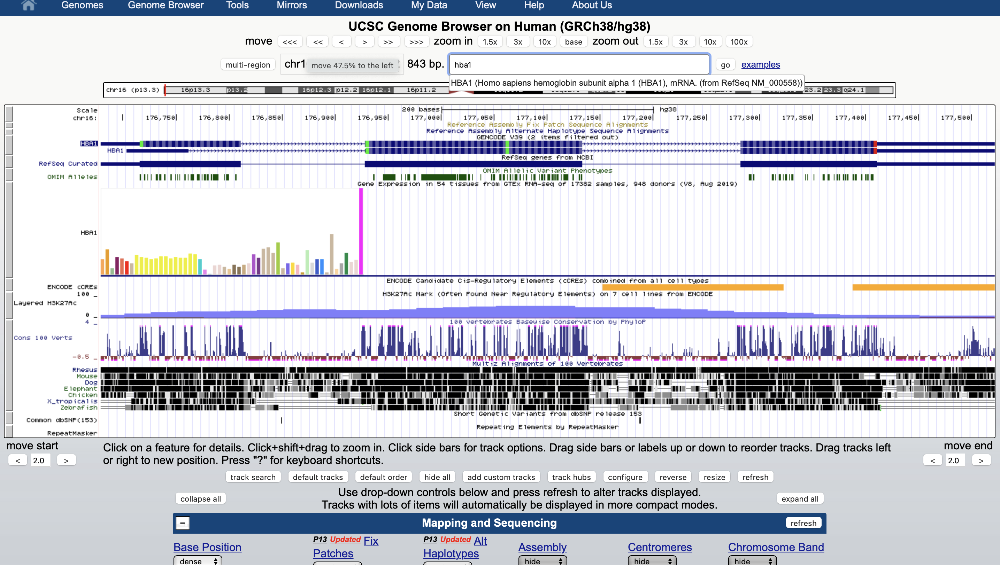

What it is needed to be highlighted:

<> Gene name - _Hemoglobin subunit alpha (HBA1)_,

<> Gene ID (from Gencode) - _ENSG00000206172.8_ [you may see it on the image 2 below],

<> Which strand is the gene encoded on / transcribed from? (+ or - strand)? - _+_ [you may see it on the images 2,3 below: "Strand: +"],

<> Chromosome - _chr16_,

<> Which arm and position does this part of chromosome belong to? - _chr16:p13.3_ (where "p" means the petit or short arm at the position 3 of chromosome 16. 13.3 - the number of a cytogenetic band). The red vertical bar shows where on the chromosome the current view is located. By the way, the designation q is for the long arm of the chromosome [you may see it on the image 1 above],

<> How may alternative transcription products (alternative transcripts) may be encoded in the gene? (How many different transcripts variants are there for this gene?) - _According to the Gencode, this gene has 2 transcripts (so, 1 alternative transcript)_. Btw, according to the Ensembl Genome Browser it has 4 transcripts; but we need to use only the Gencode information (according to the homework instructions) [you may see it on the images 2-4 below],

<> For each transcript it is needed to write its: Gencode ID, chromosome coordinates (including UTRs), number of exons (total), and length of a protein sequence (if there are more than three transcripts, then only the first three ones should be described):

1) Gencode ID - _ENST00000320868.9_,

Chromosome coordinates (including UTRs) - chr16:_176,680-177,522_ (hg38),

Number of exons - _Total Exon Count: 3_,

Length of a protein sequence - _Size: 142 aa_;

2) Gencode ID - _ENST00000397797.1_,

Chromosome coordinates (including UTRs) - chr16:_176,704-177,522_ (hg38),

Number of exons - _Total Exon Count: 3_,

Length of a protein sequence - _Size: 110 aa_.

  


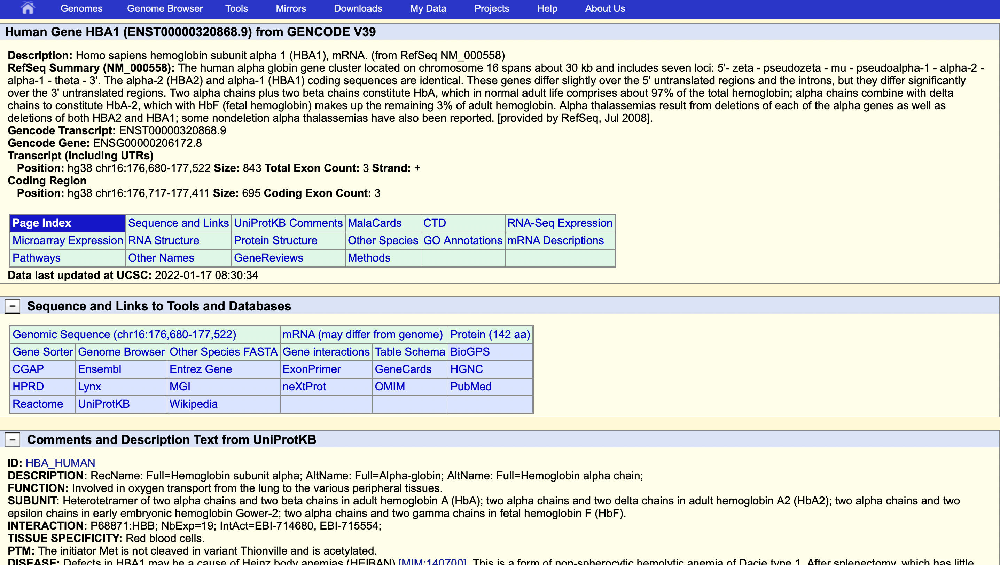

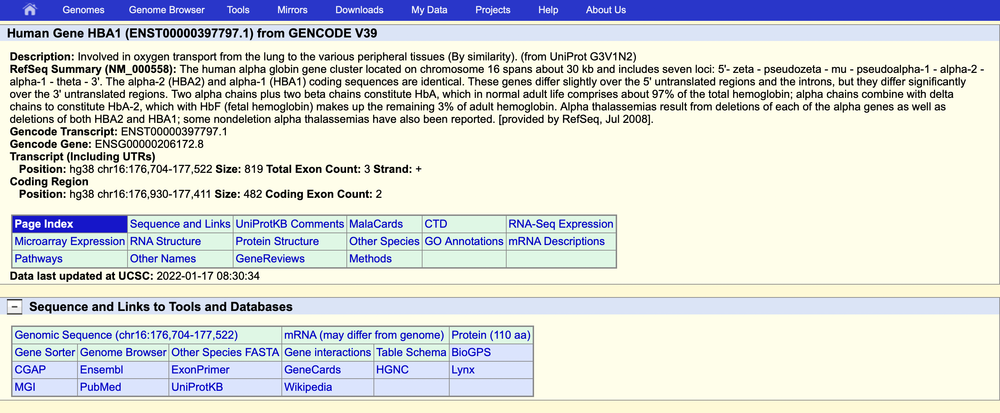

Additional information:

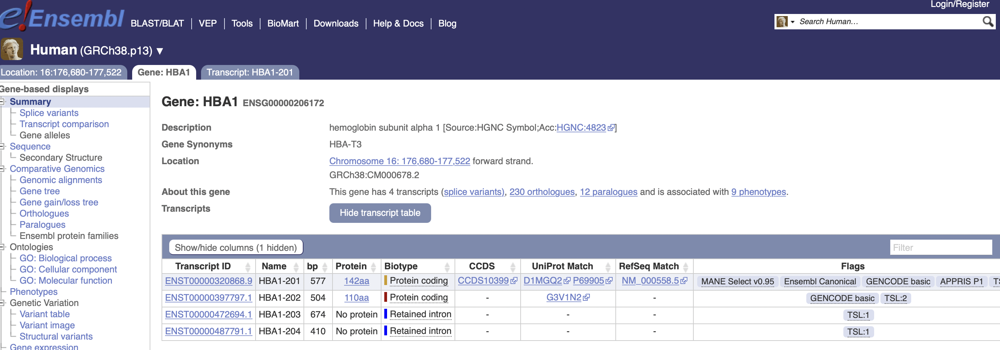

Then, save a picture of the gene's locality from the UCSC Genome Browser with the tracks: GENCODE and RefSeq transcripts, conservation of the sequence among vertebrates, frequent polymorphisms (Common SNPs) from the latest version (dbSNP(153)) and hide all other tracks.


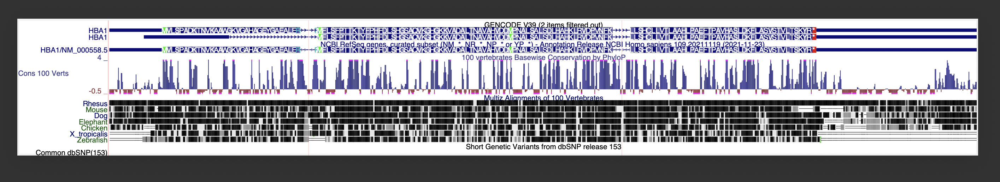

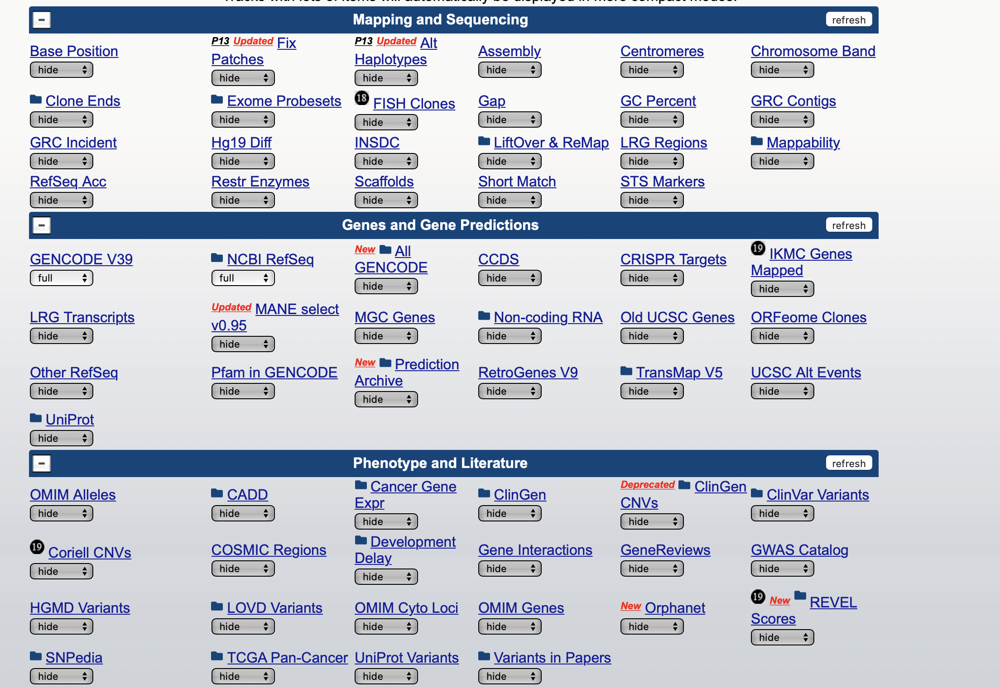

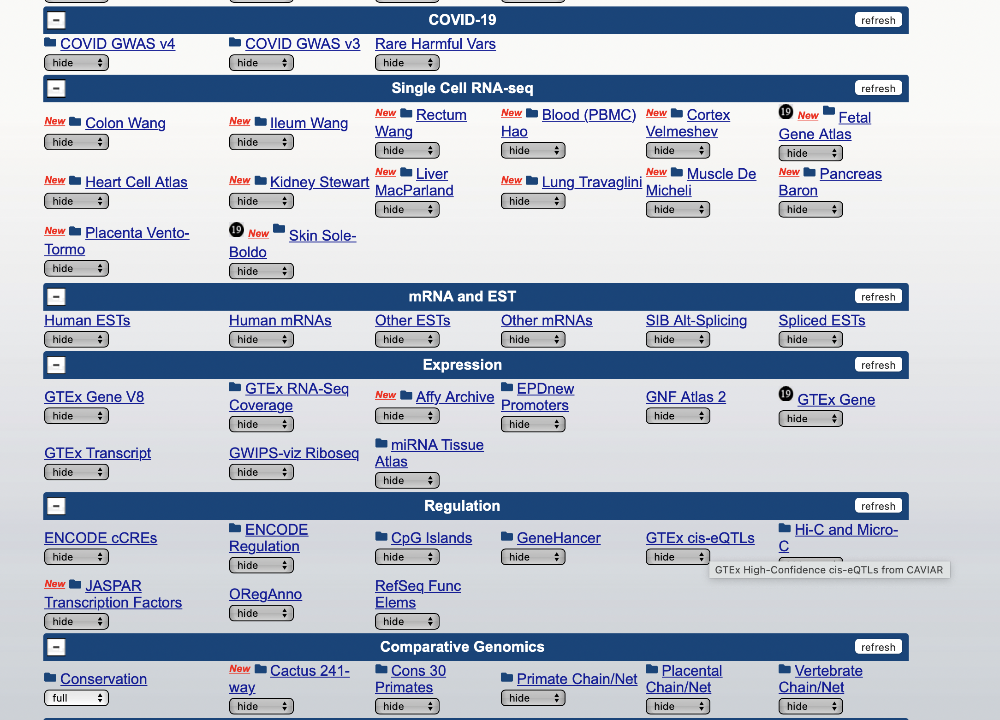

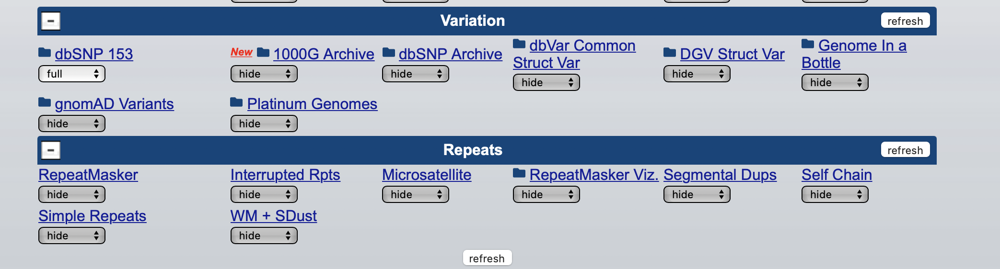

### Ensembl

Ensembl is a genome browser for vertebrate genomes that supports research in comparative genomics, evolution, sequence variation and transcriptional regulation. Ensembl annotate genes, computes multiple alignments, predicts regulatory function and collects disease data. Ensembl tools include BLAST, BLAT, BioMart and the Variant Effect Predictor (VEP) for all supported species.

https://www.ensembl.org/index.html

Align the chosen human protein gene and the homologous chimpanzee protein gene:
Find the specified gene in the Ensembl search. In the menu on the left side, select Comparative Genomics → Genomic alignments. Click Select another alignment, enter the name of the organism - Chimpanzee → Apply. Save the resulting alignment (Download).


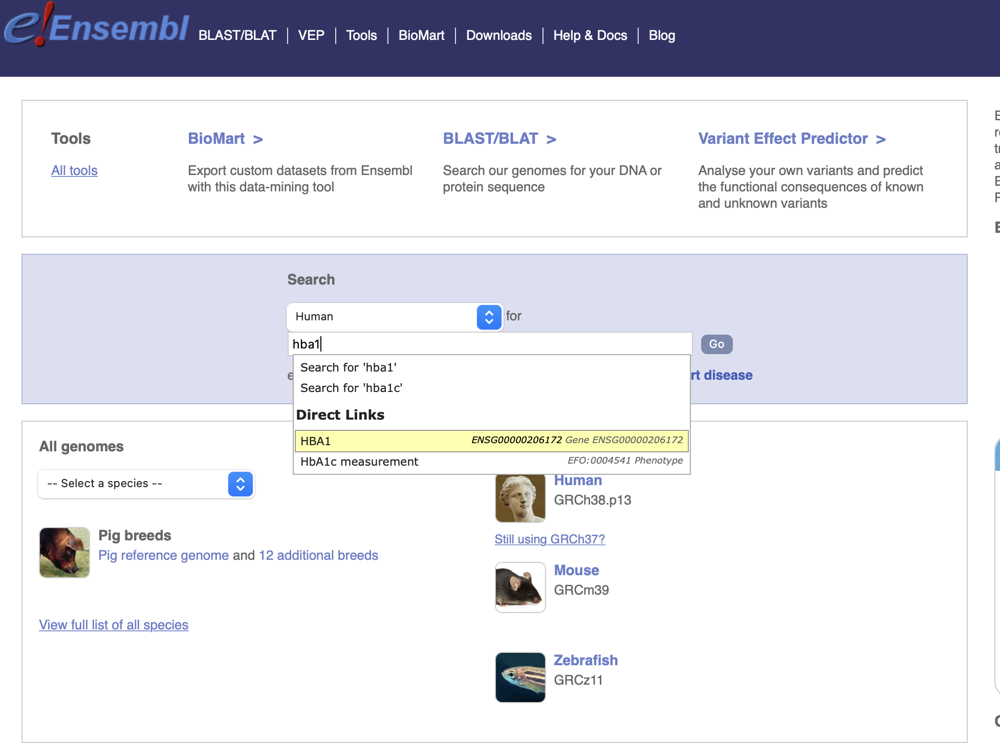

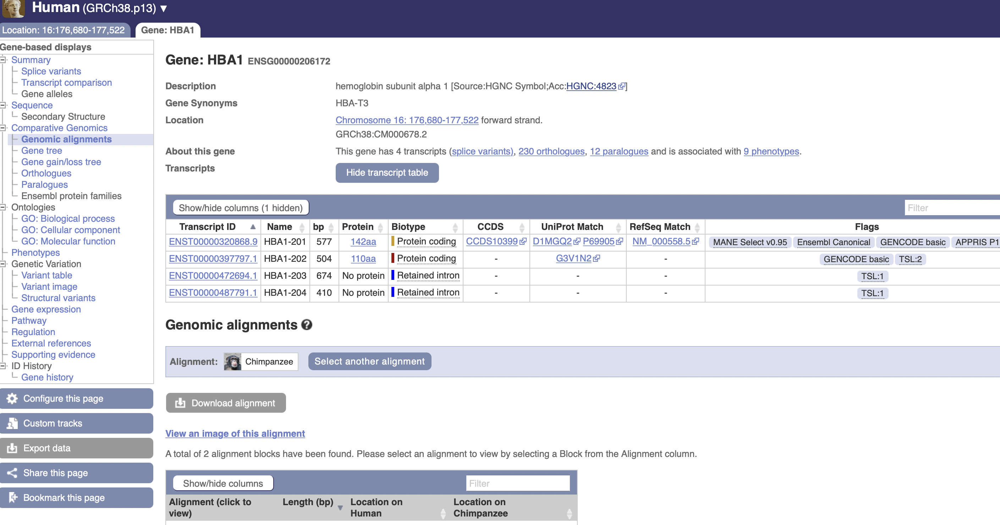

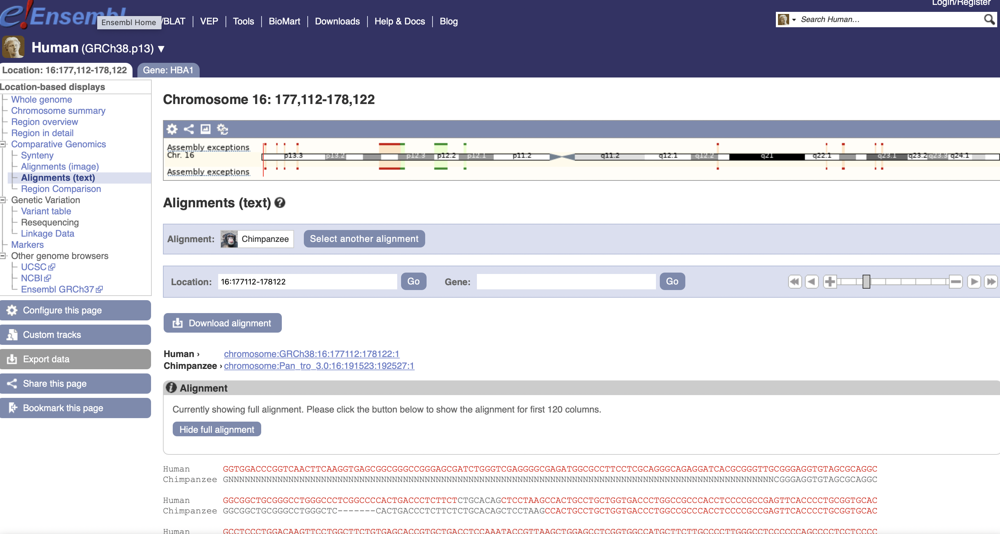

Then, we need estimate the percentage of differences per 100 nucleotides between these 2 alignments.

It can be done (to count the number of differences) by the command _infoalign_ of EMBOSS package or with biopython.

In [ ]:
!pip install biopython

     |████████████████████████████████| 2.3 MB 5.1 MB/s 


In [ ]:
from Bio import AlignIO

alignment = AlignIO.read(open('Human_Chimpanzee_HBA1.fa'), 'fasta')
seq1 = str(alignment[0].seq)
seq2 = str(alignment[1].seq)
matches = sum(nuc1 == nuc2 for nuc1, nuc2 in zip(seq1, seq2))
identity = 100.0 * matches / len(seq1)
identity # 87.4506

87.4505928853755

Compare the obtained value with the genome-wide assessment and specify the source:

From the article "Initial sequence of the chimpanzee genome and comparison with the human genome" (The Chimpanzee Sequencing and Analysis Consortium, Published: 1 September 2005, https://www.nature.com/articles/nature04072).

Section "Genome evolution. Nucleotide divergence" /

".. _Genome-wide rates_. **We calculate the genome-wide nucleotide divergence between human and chimpanzee to be 1.23%, confirming recent results from more limited studies**.. The differences between one copy of the human genome and one copy of the chimpanzee genome include both the sites of fixed divergence between the species and some polymorphic sites within each species. By correcting for the estimated coalescence times in the human and chimpanzee populations.. we estimate that polymorphism accounts for 14–22% of the observed divergence rate and thus that the fixed divergence is ∼1.06% or less.

Nucleotide divergence rates are not constant across the genome, as has been seen in comparisons of the human and murid genomes.. The average divergence in 1-Mb segments fluctuates with a standard deviation of 0.25% (coefficient of variation = 0.20), which is much greater than the 0.02% expected assuming a uniform divergence rate.."

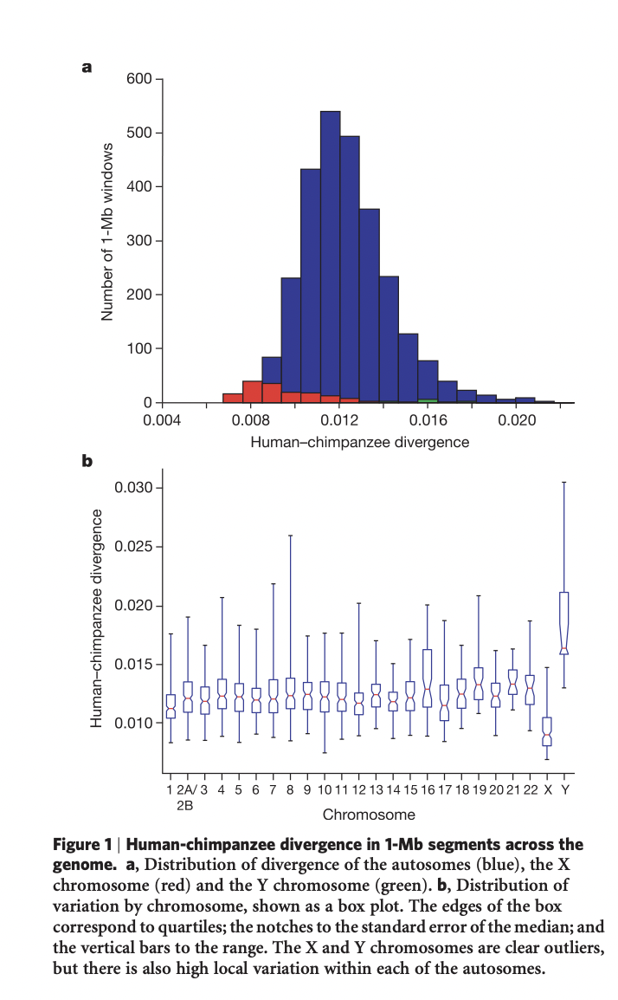

In [12]:
Divergence = 1.23
Identity_genome_wide = 100 - Divergence
Identity_genome_wide # 98.77 genome-wide assessment of identity of human and chimpanzee genomes

98.77

The Percent Difference comparison calculates the percentage difference between two number values in order to determine how close they are.

The Percent Difference (PD) between two numbers is calculated as follows:

PD = |(n2-n1)/((n1+n2)/2)|x 100%, where ni - a number.

In [15]:
PD = ((Identity_genome_wide - identity)/((Identity_genome_wide + identity)/2))*100
PD # 12.157%

12.156987515974606

### Genome Data Viewer

the link to the Genome Data Viewer is https://www.ncbi.nlm.nih.gov/genome/gdv/.

Observe the same genome fragment in the Genome Data Viewer.

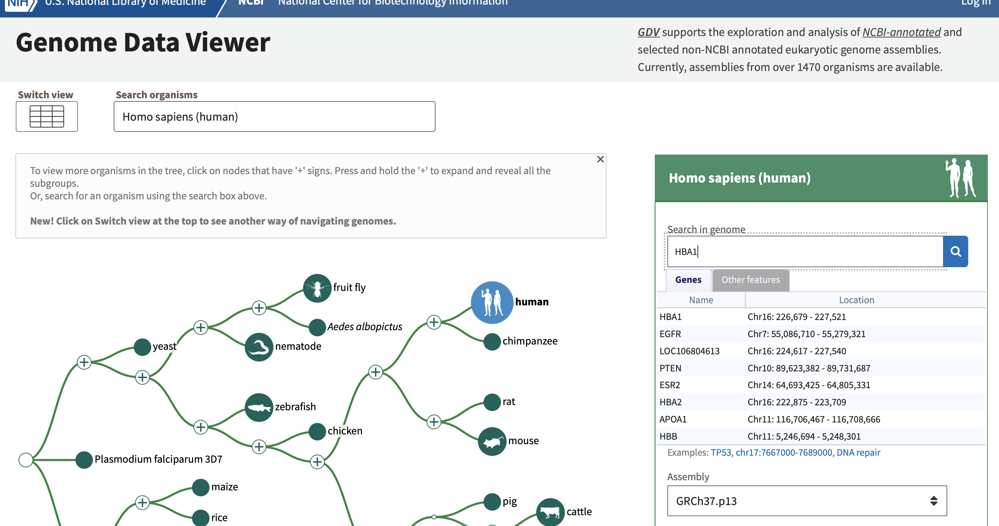

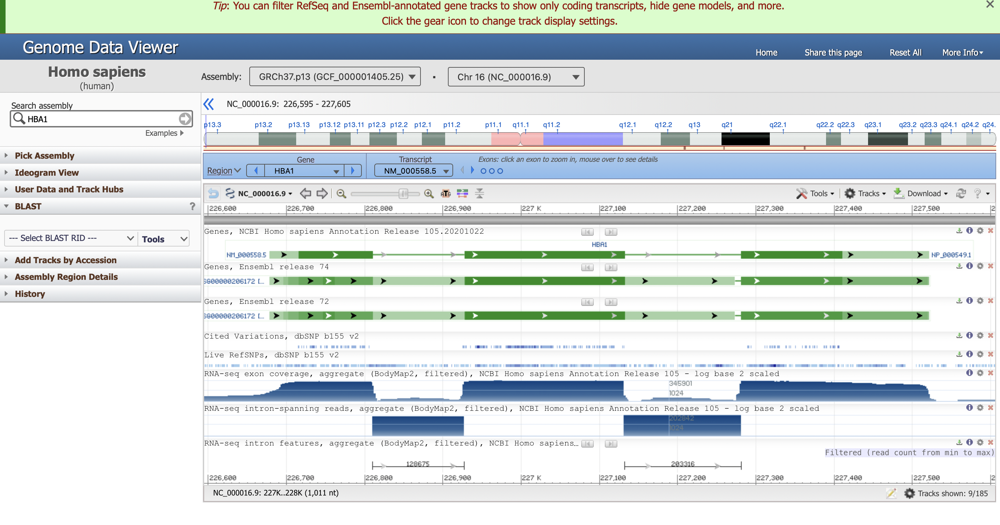

As we may see on the image above, it has an extensive track configuration (for example, we can define an exact set of nucleotides if we want either recommended NCBI track sets (may see such possibilities on the images below) and even create an own NCBI track collection).

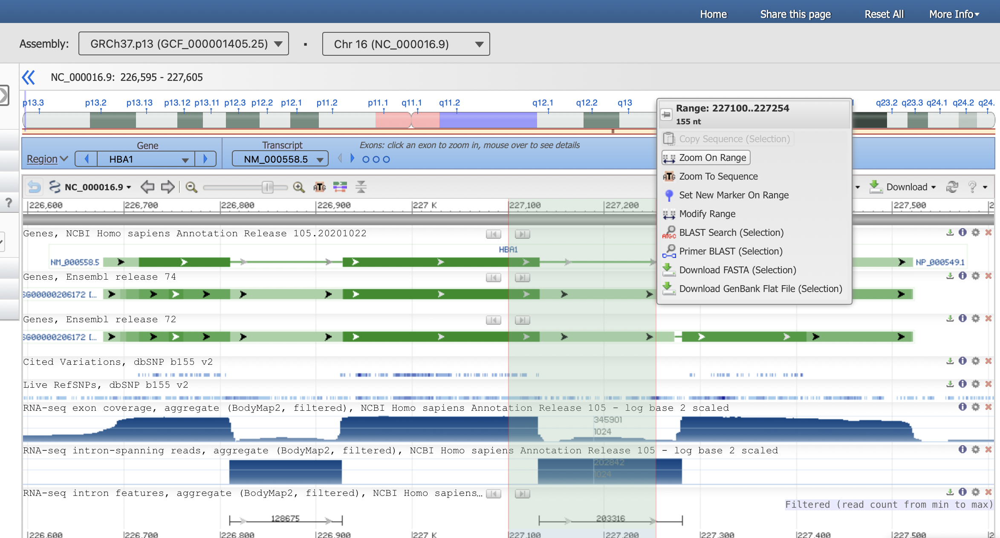

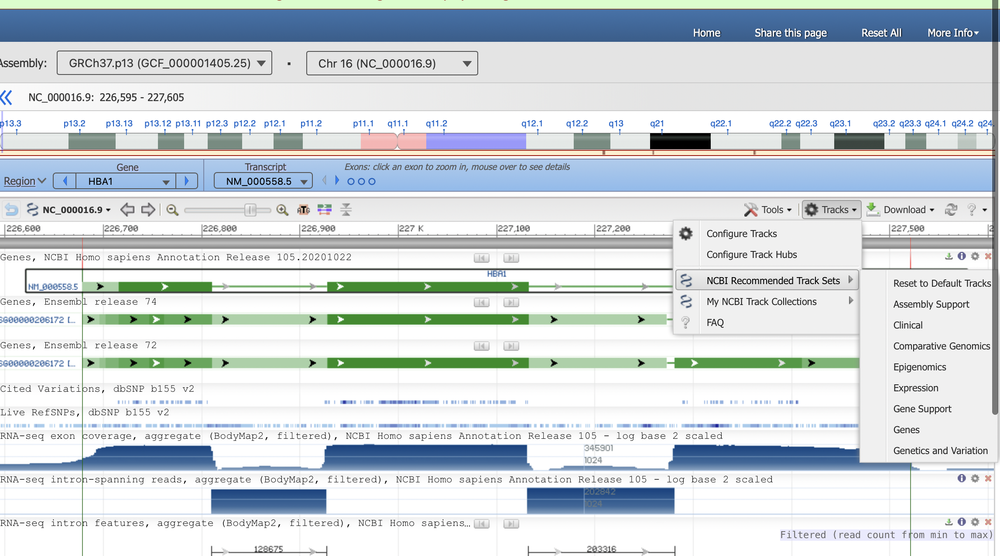

Using a blue bar we may select an exact transcript or an exon location (highlighted in green)

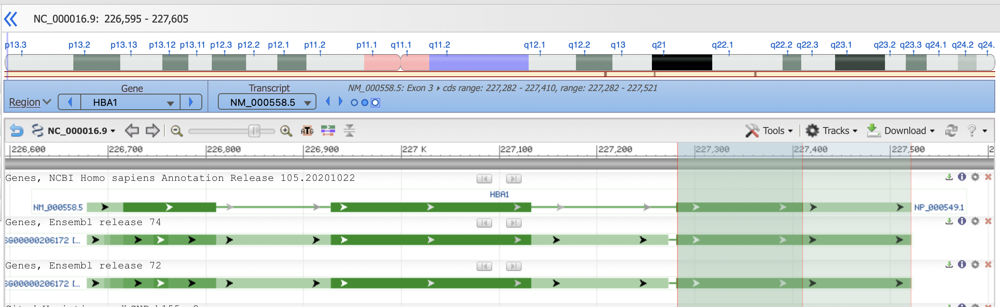

It is possible to view an exact genomic seq if we need:

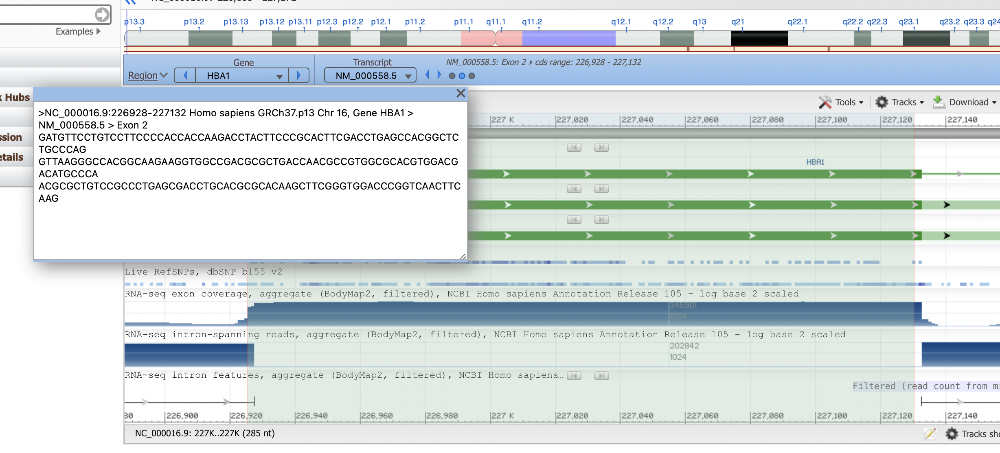

We may also set a marker at needed position (sometimes it can be useful):

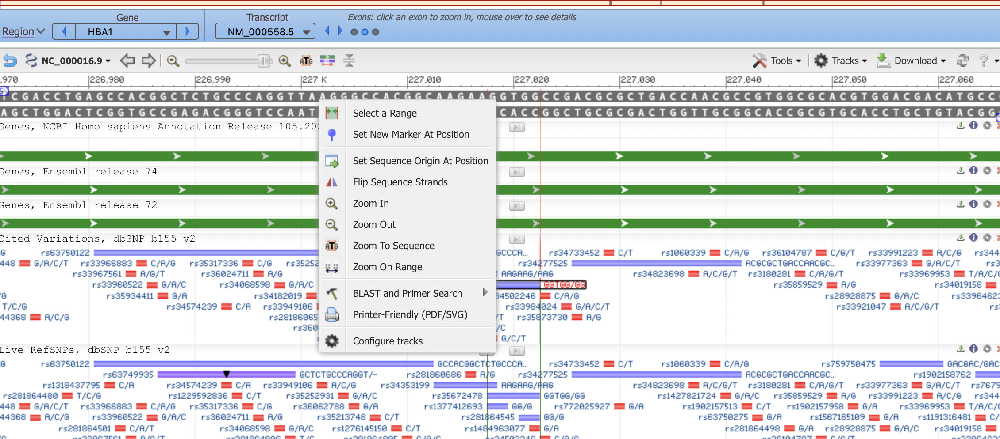

That was just a minor sample of Genome Data Viewer capabilities.

The Genome Data Viewer (GDV) is now the main genome browser at NCBI replacing the Map Viewer, NCBI's original  genome browser. GDV is a modern genome browser with essential improvements over Map Viewer. These include sequence-level details and an automated update process that keeps up with the rapid pace of genome sequencing, assembly and annotation.

The GDV home page  serves as a main access point for this large collection of organisms and assemblies.

Here are some more advantages that GDV offers over the Map Viewer:

1) It is easy to customize the display with tracks representing NCBI’s wide range of genomic data.

2) It is possible to display own data from a variety of file formats alongside NCBI tracks through the ‘Your data’ function.

3) We can share our displays with others or print publication-quality views.

The NCBI Genome Data Viewer (GDV) allows users to visualize molecular data in a genomic context. The Genome Data Viewer is used by different NCBI resources, such as the Gene Expression Omnibus (GEO) repository, to provide a graphical display of data associated with specified experiments or samples.

The core component of the GDV browser is the NCBI Sequence Viewer, which supports analysis of genomic assemblies at multiple levels, from the whole chromosome or scaffold to the sequence base pair.

The list of default tracks displayed in the Sequence Viewer widget of the GDV is specified by the context of the NCBI application that is using the GDV. For example, when viewing the GDV in the context of GEO, default tracks displayed include: sequence, CpG islands, Genes and dbSNP Cited Variants. It is also good to know that the performance of the GDV may be compromised when loading large (>200) numbers of tracks.